In [33]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from torch import nn


In [34]:
print(torch.__version__)
print(torch.cuda.is_available())
device = torch.device("cuda")

2.4.0
True


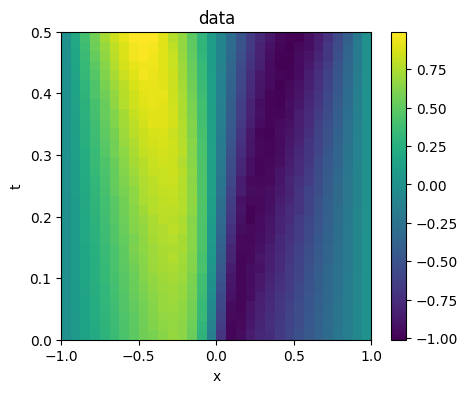

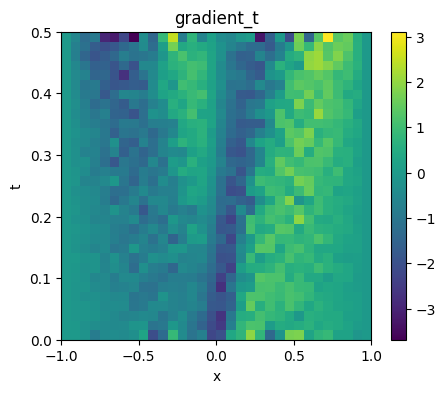

In [35]:
x = np.linspace(-1, 1, 32)  
t = np.linspace(0, 0.5, 32)
data = np.load('data_Burgers_noise0.01.npy')
dx = (1 - (-1)) / 32
dt = (0.5 - 0) / 32
gradient_x = np.gradient(data, dx, axis = 1, edge_order=2)
gradient_t = np.gradient(data, dt, axis = 0, edge_order=2)
gradient_xx = np.gradient(gradient_x, dx, axis = 1, edge_order=2)

plt.figure(figsize=(5, 4))
plt.imshow(data, aspect='auto',extent=[np.min(x), np.max(x), np.min(t), np.max(t)], cmap='viridis')
plt.title('data')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(gradient_t, aspect='auto',extent=[np.min(x), np.max(x), np.min(t), np.max(t)], cmap='viridis')
plt.title('gradient_t')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

data = torch.from_numpy(data)
x = torch.from_numpy(x)
t = torch.from_numpy(t)
gradient_x = torch.from_numpy(gradient_x)
gradient_xx = torch.from_numpy(gradient_xx)
gradient_t = torch.from_numpy(gradient_t)


x = x.float().to(device)
t = t.float().to(device)
data = data.float().to(device)
gradient_x = gradient_x.float().to(device)
gradient_xx = gradient_xx.float().to(device)
gradient_t = gradient_t.float().to(device)


In [36]:
print(data.shape)
print(t.shape)
print(x.shape)
print(gradient_x.shape)
print(gradient_t.shape)


torch.Size([32, 32])
torch.Size([32])
torch.Size([32])
torch.Size([32, 32])
torch.Size([32, 32])


In [37]:
#обучение на одном интеграле с early stopping на loss и на градиенты и с динамическим lr(лучше по t, те ouput1)
import torch.optim as optim

# Определение модели
model = torch.nn.Sequential(
    torch.nn.Linear(2, 1024),
    torch.nn.ReLU(),
    torch.nn.Linear(1024, 512),
    torch.nn.ReLU(),
    torch.nn.Linear(512, 256),
    torch.nn.ReLU(),
    torch.nn.Linear(256, 128),
    torch.nn.ReLU(),
    torch.nn.Linear(128, 64),
    torch.nn.ReLU(),
    torch.nn.Linear(64, 32),
    torch.nn.ReLU(),
    torch.nn.Linear(32, 16),
    torch.nn.ReLU(),
    torch.nn.Linear(16, 8),
    torch.nn.ReLU(),
    torch.nn.Linear(8, 2)
).to(device)

criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2000, factor=0.7)

grid_points = torch.stack(torch.meshgrid(t, x, indexing='ij'), dim=-1).reshape(-1, 2).to(device)

def integrate_gradients(dx, dy, initial_value):
    
    integral_y= torch.zeros_like(dx)
    integral_y[0] = initial_value  
    for i in range(1, dy.shape[0]):
        integral_y[:, i] = integral_y[:, i - 1] + ((dy[:, i] + dy[:, i - 1])) / 2  
    
    integral_x = torch.zeros_like(dy)
    integral_x[0] = integral_y[0] 
    
    for j in range(1, dx.shape[1]):
        integral_x[j] = integral_x[j - 1] + ((dx[j] + dx[j - 1])) / 2  

    return integral_x

losses = []
initial_value = data[0, 0]
best_loss = float('inf')#хранит наименьшее значение потерь, достигнутое моделью. Изначально оно установлено в бесконечность
patience_counter = 0#отслеживает количество эпох с ухудшением потерь.
patience_limit = 10000  #задает максимальное количество эпох без улучшения, после которого обучение будет остановлено.
target_accuracy = 0.0005  # желаемая точность

for epoch in range(400000):
    optimizer.zero_grad()
    output = model(grid_points).reshape(32, 32, 2).to(device)
    output1 = output[:,:,0]
    output2 = output[:,:,1]
    integral = integrate_gradients(output1, output2, initial_value).to(device)
    loss = criterion(integral, data)                                                   
    loss.backward()                                                                   
    optimizer.step()                                                                  
    # Динамическое изменение learning rate
    scheduler.step(loss)#позволяет планировщику изменять learning rate на основе текущих потерь. Если потери не улучшаются в течение заданного количества эпох (patience), learning rate уменьшается на указанный фактор.
    losses.append(loss.item())                                                        
    print(f'Epoch {epoch}, Loss: {loss.item()}')
    '''
    # Проверка на достижение целевой точности
    accuracy_x = torch.mean(torch.square(gradient_x - output1))
    accuracy_y = torch.mean(torch.square(gradient_y - output2))
    accuracy = (torch.mean(torch.square(gradient_x - output1)) + torch.mean(torch.square(gradient_y - output2))) / 2
    print('mse_gradients_x = ', accuracy_x)
    print('mse_gradients_y = ', accuracy_y)
    print('mse_gradients = ', accuracy)

    if accuracy_x < target_accuracy:
        print(f'Целевая точность достигнута на эпохе {epoch}. Остановка обучения.')
        break
    '''

    # Ранняя остановка
    if loss.item() < best_loss:#Если текущие потери меньше, чем best_loss, то обновляем best_loss и сбрасываем patience_counter.
        best_loss = loss.item()
        patience_counter = 0
        # Сохранение модели (если нужно)
        # torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1#Если текущие потери не улучшаются, увеличиваем patience_counter.
        
        if patience_counter >= patience_limit:#Если patience_counter достигает patience_limit, выводим сообщение о срабатывании ранней остановки и прерываем цикл обучения.
            print("Early stopping triggered.")
            break

print(output1.shape)
print(output2.shape)




Epoch 0, Loss: 34.3157844543457
Epoch 1, Loss: 31.741458892822266
Epoch 2, Loss: 29.357421875
Epoch 3, Loss: 27.13363265991211
Epoch 4, Loss: 24.211551666259766
Epoch 5, Loss: 18.98642349243164
Epoch 6, Loss: 13.091883659362793
Epoch 7, Loss: 7.134057998657227
Epoch 8, Loss: 2.382193088531494
Epoch 9, Loss: 1.950569987297058
Epoch 10, Loss: 5.417546272277832
Epoch 11, Loss: 4.159402847290039
Epoch 12, Loss: 1.3554573059082031
Epoch 13, Loss: 0.4020438492298126
Epoch 14, Loss: 0.8876248598098755
Epoch 15, Loss: 1.510624885559082
Epoch 16, Loss: 1.6269278526306152
Epoch 17, Loss: 1.252037525177002
Epoch 18, Loss: 0.6752811670303345
Epoch 19, Loss: 0.2925385534763336
Epoch 20, Loss: 0.6555502414703369
Epoch 21, Loss: 1.013503074645996
Epoch 22, Loss: 0.7343842387199402
Epoch 23, Loss: 0.4421660900115967
Epoch 24, Loss: 0.30852097272872925
Epoch 25, Loss: 0.3285277485847473
Epoch 26, Loss: 0.39769747853279114
Epoch 27, Loss: 0.40232378244400024
Epoch 28, Loss: 0.3356173038482666
Epoch 29, 

Epoch 53, Loss: 0.2298239916563034
Epoch 54, Loss: 0.22960533201694489
Epoch 55, Loss: 0.2243930846452713
Epoch 56, Loss: 0.219717875123024
Epoch 57, Loss: 0.21925035119056702
Epoch 58, Loss: 0.2207992970943451
Epoch 59, Loss: 0.22021910548210144
Epoch 60, Loss: 0.2167815864086151
Epoch 61, Loss: 0.21349641680717468
Epoch 62, Loss: 0.21289658546447754
Epoch 63, Loss: 0.2139354944229126
Epoch 64, Loss: 0.21378326416015625
Epoch 65, Loss: 0.21173687279224396
Epoch 66, Loss: 0.20974552631378174
Epoch 67, Loss: 0.20934456586837769
Epoch 68, Loss: 0.20970919728279114
Epoch 69, Loss: 0.20914137363433838
Epoch 70, Loss: 0.20739349722862244
Epoch 71, Loss: 0.20574666559696198
Epoch 72, Loss: 0.20510941743850708
Epoch 73, Loss: 0.2048753798007965
Epoch 74, Loss: 0.20399221777915955
Epoch 75, Loss: 0.2024995982646942
Epoch 76, Loss: 0.20130857825279236
Epoch 77, Loss: 0.20079152286052704
Epoch 78, Loss: 0.20036670565605164
Epoch 79, Loss: 0.1994606852531433
Epoch 80, Loss: 0.19828473031520844
Ep

0.89333606


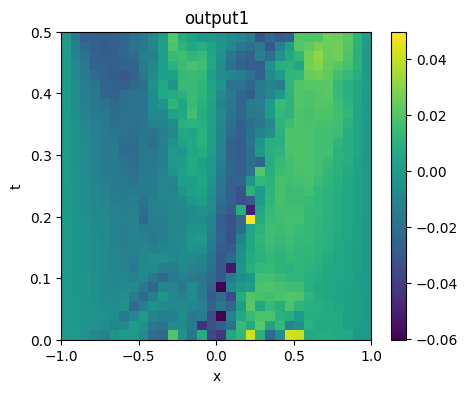

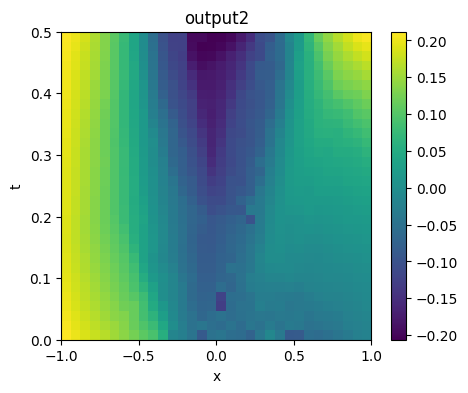

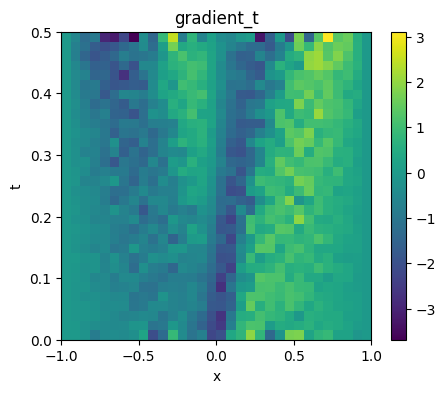

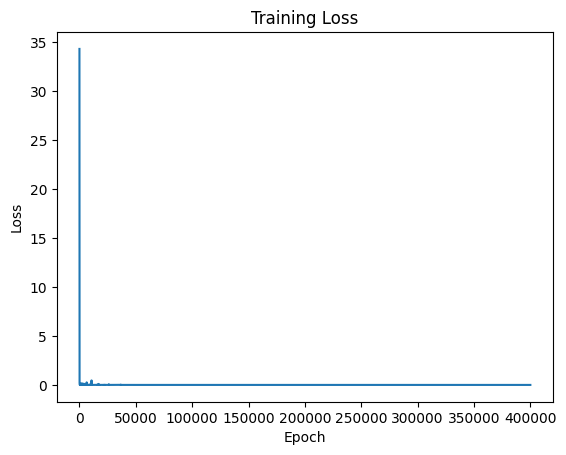

In [38]:
output1 = output1.detach().cpu().numpy() 
output2 = output2.detach().cpu().numpy() 
x =  x.detach().cpu().numpy() 
t =  t.detach().cpu().numpy() 
data = data.detach().cpu().numpy() 
gradient_x = gradient_x.detach().cpu().numpy() 
gradient_t = gradient_t.detach().cpu().numpy() 
print((np.square(output1 - gradient_t)).mean(axis=None))

plt.figure(figsize=(5, 4))
plt.imshow(output1, aspect='auto',extent=[np.min(x), np.max(x), np.min(t), np.max(t)], cmap='viridis')
plt.title('output1')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(output2, aspect='auto',extent=[np.min(x), np.max(x), np.min(t), np.max(t)], cmap='viridis')
plt.title('output2')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(gradient_t, aspect='auto',extent=[np.min(x), np.max(x), np.min(t), np.max(t)], cmap='viridis')
plt.title('gradient_t')
plt.xlabel('x')
plt.ylabel('t')
plt.colorbar()
plt.show()


plt.plot(losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.show()

In [39]:
np.save('Burgers_Inverse_t_noise0.01.npy', output1)

32
32
0.0001977306819254405
5.106928229819491e-05
8.425561139664857e-05


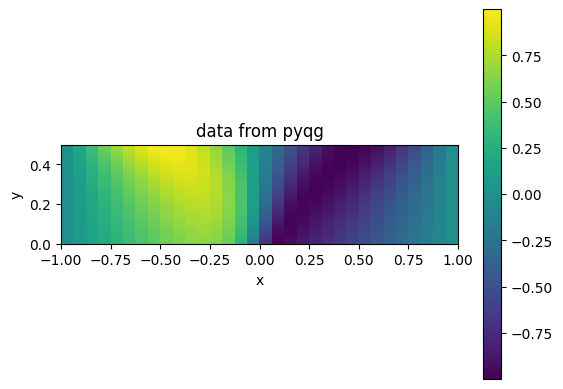

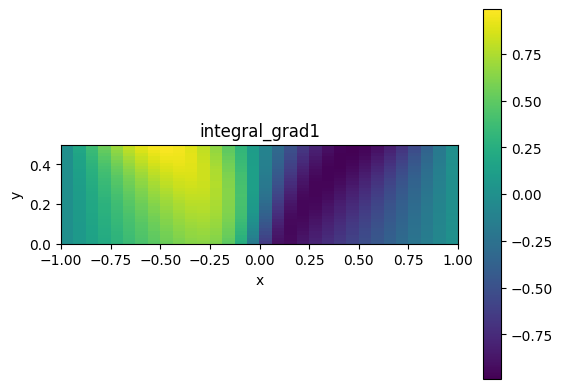

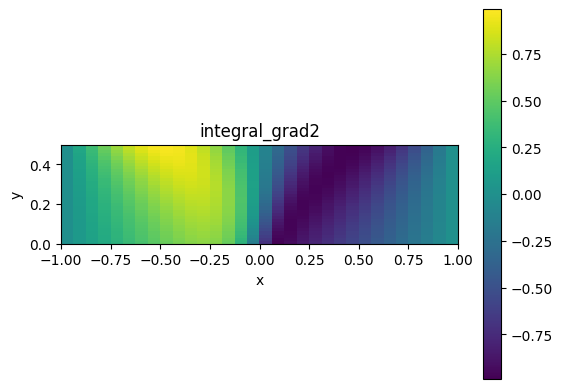

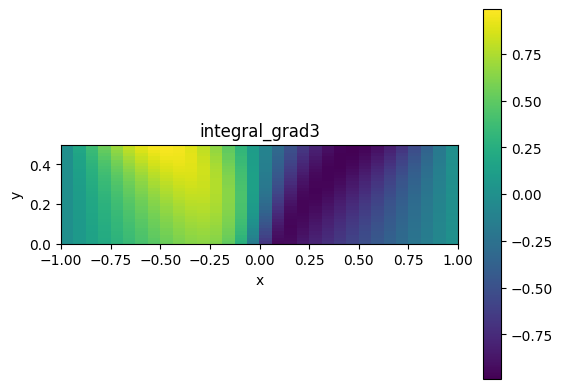

In [ ]:
x = np.linspace(-1, 1, 32)  
y = np.linspace(0, 0.5, 32)
data = np.load('data_Burgers_noise0.npy')

# Функция для вычисления производных
def compute_gradients(data):
    dx = np.gradient(data, axis=0) 
    dy = np.gradient(data, axis=1)
    return dx, dy

def integrate_gradients1(dx, dy, initial_value):
    
    integral_x = np.zeros_like(dx)
    integral_x[0] = initial_value  
    for i in range(1, dx.shape[0]):
        integral_x[i] = integral_x[i - 1] + ((dx[i] + dx[i - 1])) / 2  
    
    integral_y = np.zeros_like(dy)
    integral_y[:, 0] = integral_x[:, 0] 
    
    for j in range(1, dy.shape[1]):
        integral_y[:, j] = integral_y[:, j - 1] + ((dy[:, j] + dy[:, j - 1])) / 2  

    return integral_y

def integrate_gradients2(dx, dy, initial_value):
    
    integral_y= np.zeros_like(dx)
    integral_y[0] = initial_value  
    for i in range(1, dy.shape[0]):
        integral_y[:, i] = integral_y[:, i - 1] + ((dy[:, i] + dy[:, i - 1])) / 2  
    
    integral_x = np.zeros_like(dy)
    integral_x[0] = integral_y[0] 
    
    for j in range(1, dx.shape[1]):
        integral_x[j] = integral_x[j - 1] + ((dx[j] + dx[j - 1])) / 2  

    return integral_x 


dx, dy = compute_gradients(data)
initial_value = 0

print(dy.shape[0])
print(dx.shape[1])

result1 = integrate_gradients1(dx, dy, initial_value)
result2 = integrate_gradients2(dx, dy, initial_value)

result3 = ((integrate_gradients1(dx, dy, initial_value) + integrate_gradients2(dx, dy, initial_value)) / 2)


print((np.square(data - result1)).mean(axis=None))
print((np.square(data - result2)).mean(axis=None))
print((np.square(data - result3)).mean(axis=None))


plt.figure(figsize=(5, 4))
plt.imshow(data, aspect='auto', extent=[np.min(x), np.max(x),np.min(y), np.max(y)], cmap='viridis')
plt.colorbar()
plt.title('data kdv')
plt.xlabel('x')
plt.ylabel('t')
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(result1, aspect='auto', extent=[np.min(x), np.max(x),np.min(y), np.max(y)], cmap='viridis')
plt.colorbar()
plt.title('integral_grad1')
plt.xlabel('x')
plt.ylabel('t')
plt.show()


plt.figure(figsize=(5, 4))
plt.imshow(result2, aspect='auto', extent=[np.min(x), np.max(x),np.min(y), np.max(y)], cmap='viridis')
plt.colorbar()
plt.title('integral_grad2')
plt.xlabel('x')
plt.ylabel('t')
plt.show()

plt.figure(figsize=(5, 4))
plt.imshow(result3, aspect='auto', extent=[np.min(x), np.max(x),np.min(y), np.max(y)], cmap='viridis')
plt.colorbar()
plt.title('integral_grad3')
plt.xlabel('x')
plt.ylabel('t')
plt.show()
